# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder

import numpy as np
import matplotlib.pyplot as plt
from gan.utils import show_images

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 512
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

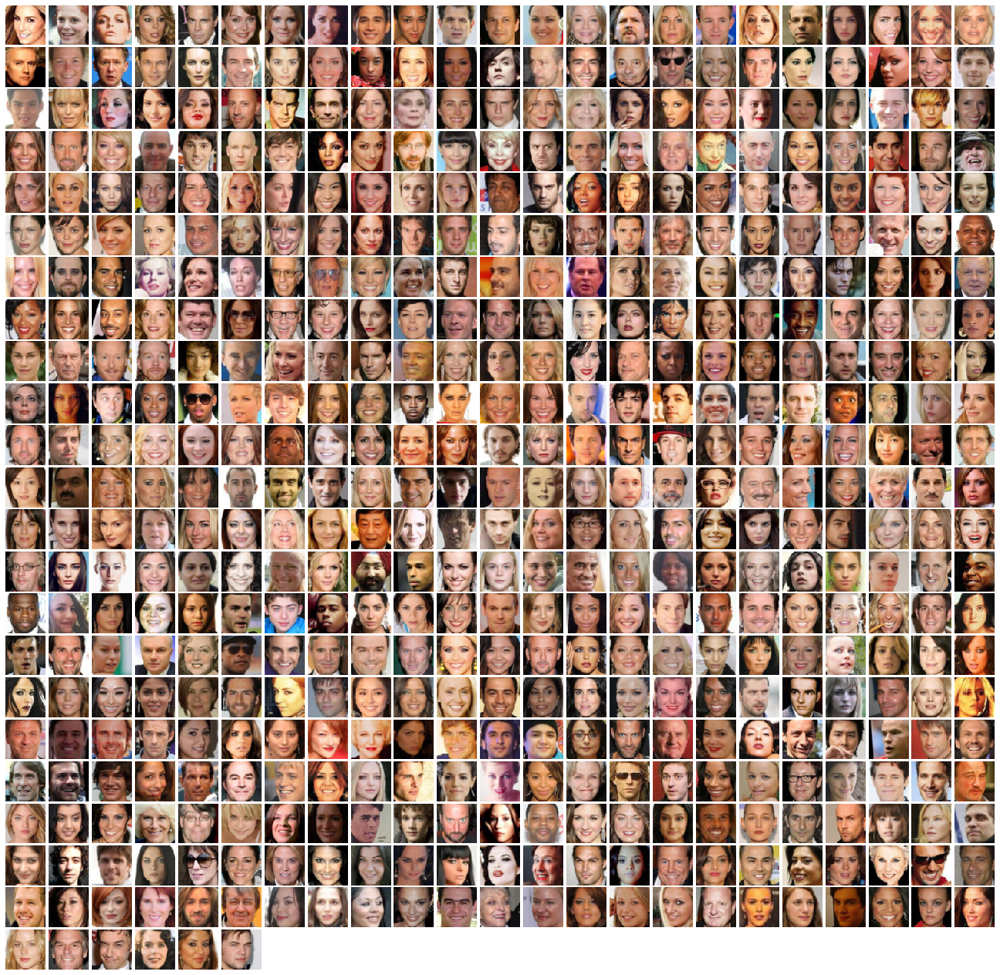

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0002

### Train GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.008, G:0.7975


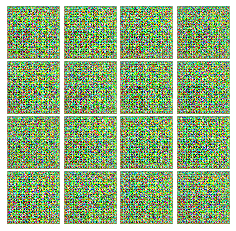


Iter: 150, D: 0.9507, G:0.7881


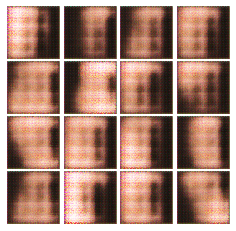


EPOCH:  2
Iter: 300, D: 0.9403, G:0.5835


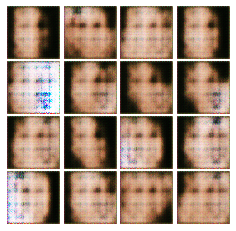


Iter: 450, D: 0.9096, G:0.5104


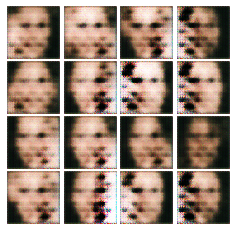


EPOCH:  3
Iter: 600, D: 0.9542, G:0.5133


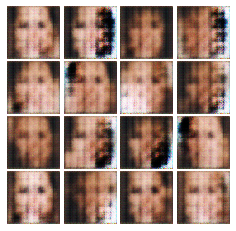


EPOCH:  4
Iter: 750, D: 0.9548, G:0.6075


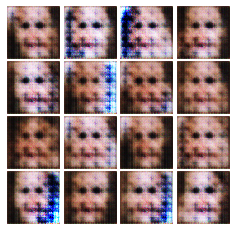


Iter: 900, D: 0.922, G:0.5674


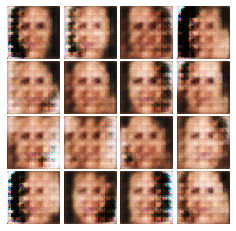


EPOCH:  5
Iter: 1050, D: 0.9767, G:0.5567


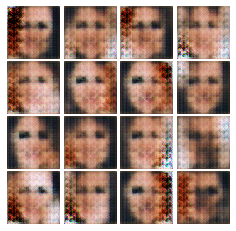


Iter: 1200, D: 0.8746, G:0.6244


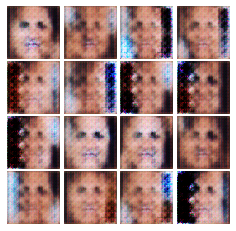


EPOCH:  6
Iter: 1350, D: 0.8376, G:0.6477


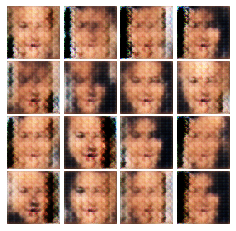


EPOCH:  7
Iter: 1500, D: 0.9193, G:0.6616


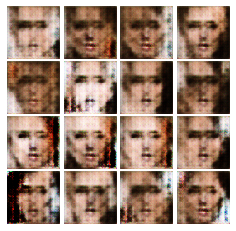


Iter: 1650, D: 0.8319, G:0.5726


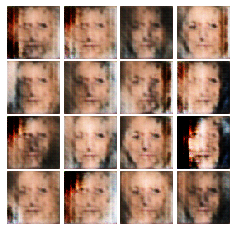


EPOCH:  8
Iter: 1800, D: 0.8787, G:0.6171


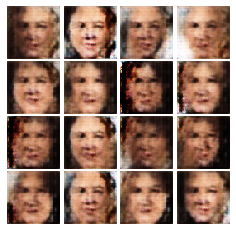


Iter: 1950, D: 0.76, G:0.5925


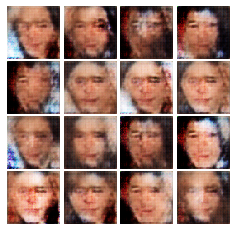


EPOCH:  9
Iter: 2100, D: 0.9518, G:0.6912


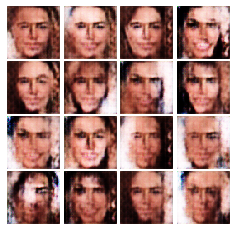


EPOCH:  10
Iter: 2250, D: 0.8111, G:0.7092


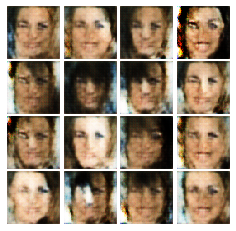


Iter: 2400, D: 0.8553, G:0.6667


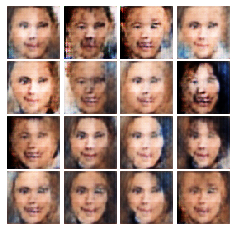


EPOCH:  11
Iter: 2550, D: 0.94, G:0.6888


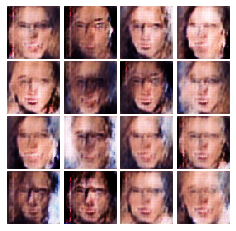


Iter: 2700, D: 0.871, G:0.6018


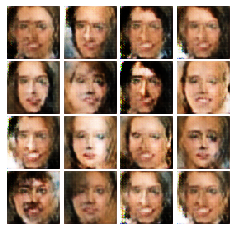


EPOCH:  12
Iter: 2850, D: 0.8998, G:0.7553


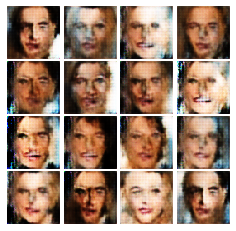


EPOCH:  13
Iter: 3000, D: 0.9141, G:0.6034


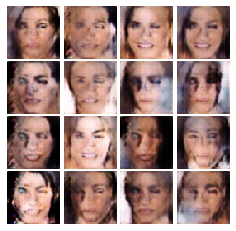


Iter: 3150, D: 0.9006, G:0.5912


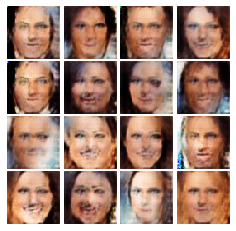


EPOCH:  14
Iter: 3300, D: 0.9308, G:0.5988


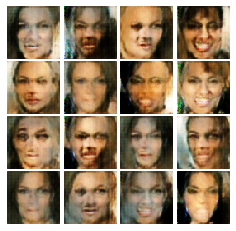


EPOCH:  15
Iter: 3450, D: 0.863, G:0.6051


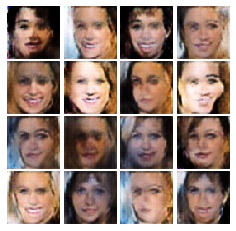


Iter: 3600, D: 0.8822, G:0.6976


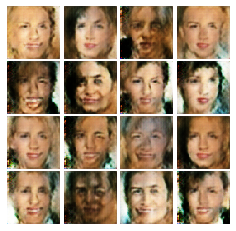


EPOCH:  16
Iter: 3750, D: 0.7774, G:0.7491


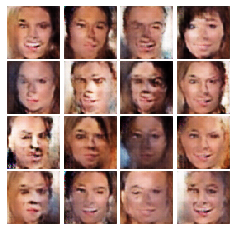


Iter: 3900, D: 0.872, G:0.583


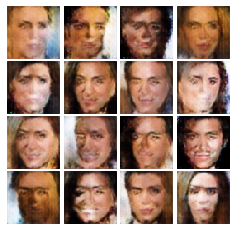


EPOCH:  17
Iter: 4050, D: 0.886, G:0.7211


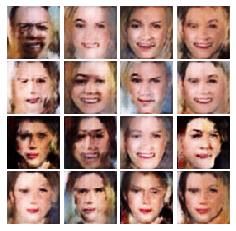


EPOCH:  18
Iter: 4200, D: 0.879, G:0.6286


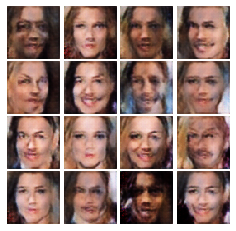


Iter: 4350, D: 0.8692, G:0.6816


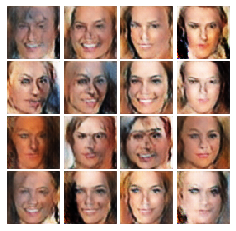


EPOCH:  19
Iter: 4500, D: 0.9174, G:0.5762


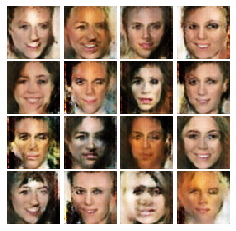


Iter: 4650, D: 0.8693, G:0.6193


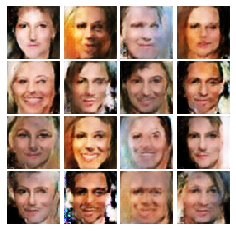


EPOCH:  20
Iter: 4800, D: 0.8765, G:0.6246


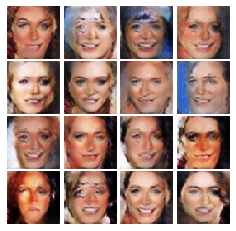


EPOCH:  21
Iter: 4950, D: 0.9059, G:0.594


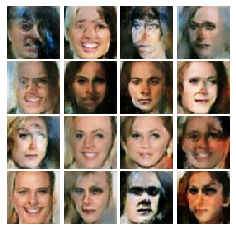


Iter: 5100, D: 0.8523, G:0.7562


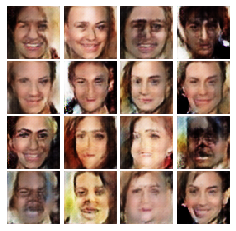


EPOCH:  22
Iter: 5250, D: 0.8464, G:0.591


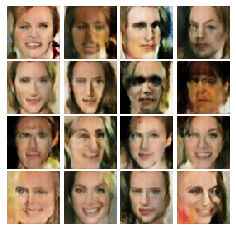


Iter: 5400, D: 0.8605, G:0.689


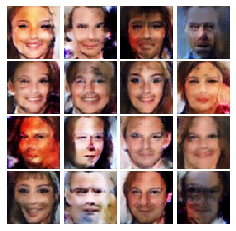


EPOCH:  23
Iter: 5550, D: 0.8381, G:0.6267


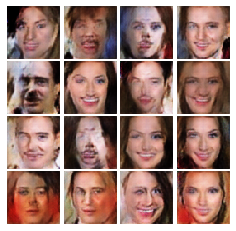


EPOCH:  24
Iter: 5700, D: 0.8703, G:0.5996


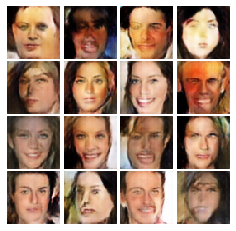


Iter: 5850, D: 0.9396, G:0.8051


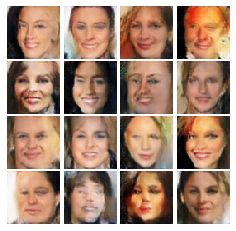


EPOCH:  25
Iter: 6000, D: 0.9028, G:0.6496


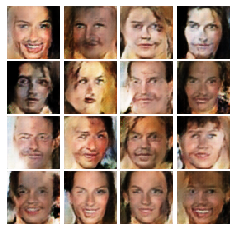


EPOCH:  26
Iter: 6150, D: 0.8966, G:0.7421


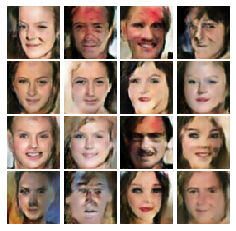


Iter: 6300, D: 0.8727, G:0.7244


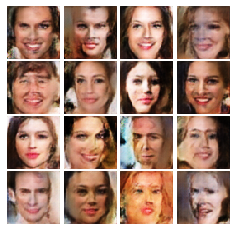


EPOCH:  27
Iter: 6450, D: 0.8566, G:0.7595


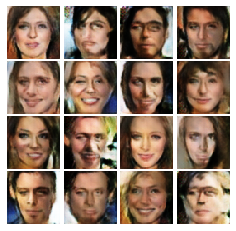


Iter: 6600, D: 0.8595, G:0.629


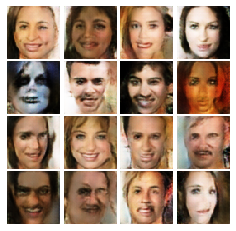


EPOCH:  28
Iter: 6750, D: 0.8666, G:0.6132


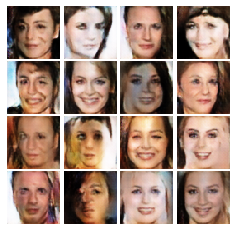


EPOCH:  29
Iter: 6900, D: 0.8607, G:0.645


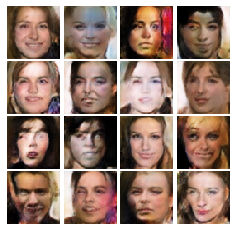


Iter: 7050, D: 0.8728, G:0.6228


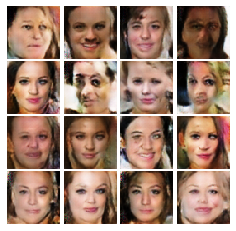


EPOCH:  30
Iter: 7200, D: 0.915, G:0.6205


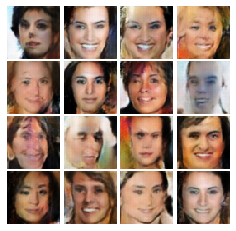


Iter: 7350, D: 0.8615, G:0.6228


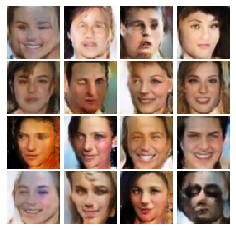


EPOCH:  31
Iter: 7500, D: 0.8925, G:0.646


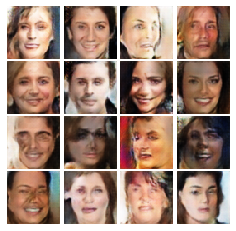


EPOCH:  32
Iter: 7650, D: 0.8926, G:0.5713


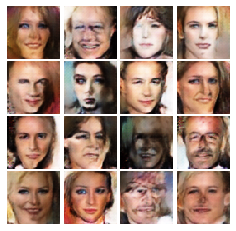


Iter: 7800, D: 0.8384, G:0.5874


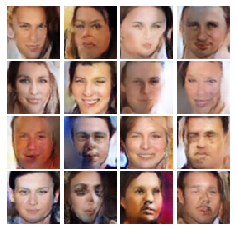


EPOCH:  33
Iter: 7950, D: 0.9065, G:0.5711


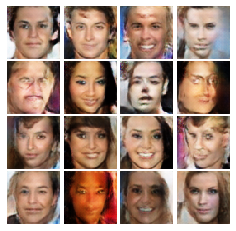


Iter: 8100, D: 0.8864, G:0.5667


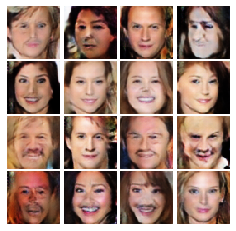


EPOCH:  34
Iter: 8250, D: 0.9419, G:1.019


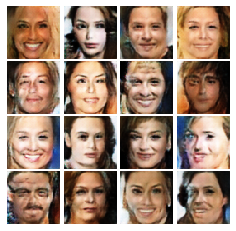


EPOCH:  35
Iter: 8400, D: 0.8886, G:0.6089


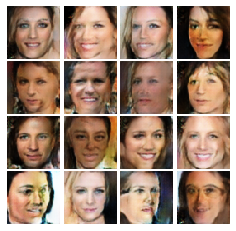


Iter: 8550, D: 0.8518, G:0.6121


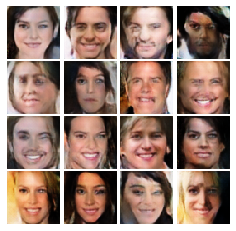


EPOCH:  36
Iter: 8700, D: 0.8818, G:0.6274


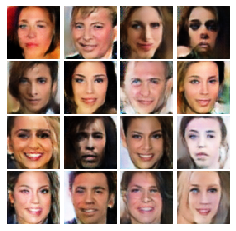


Iter: 8850, D: 0.9291, G:0.6455


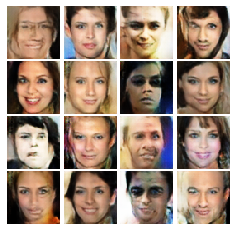


EPOCH:  37
Iter: 9000, D: 0.9, G:0.6581


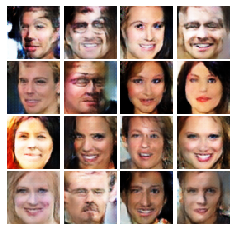


EPOCH:  38
Iter: 9150, D: 0.8881, G:0.5826


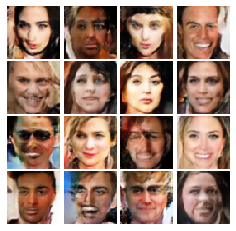


Iter: 9300, D: 0.8501, G:0.6005


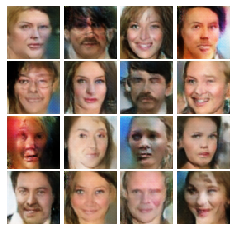


EPOCH:  39
Iter: 9450, D: 0.8687, G:0.5865


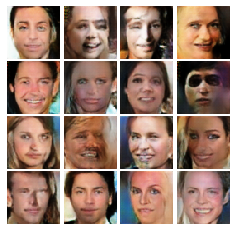


EPOCH:  40
Iter: 9600, D: 0.8543, G:0.6329


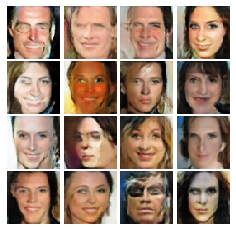


Iter: 9750, D: 0.8575, G:0.584


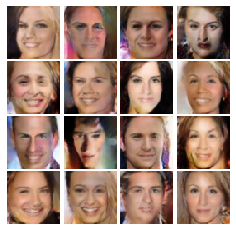


EPOCH:  41
Iter: 9900, D: 0.8692, G:0.5684


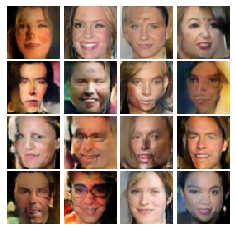


Iter: 10050, D: 0.8882, G:0.6638


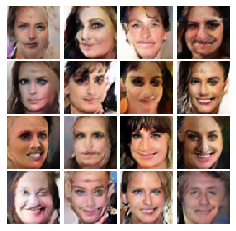


EPOCH:  42
Iter: 10200, D: 0.9026, G:0.6654


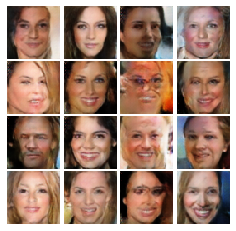


EPOCH:  43
Iter: 10350, D: 0.9214, G:0.4952


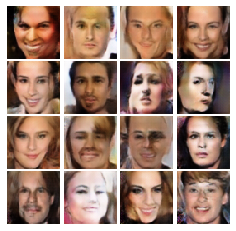


Iter: 10500, D: 0.8831, G:0.6541


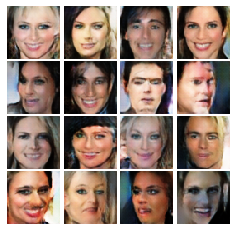


EPOCH:  44
Iter: 10650, D: 0.8794, G:0.5816


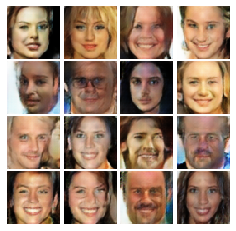


Iter: 10800, D: 0.8961, G:0.4865


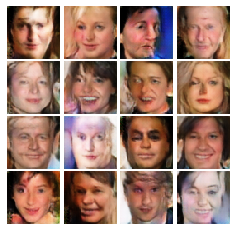


EPOCH:  45
Iter: 10950, D: 0.8874, G:0.6542


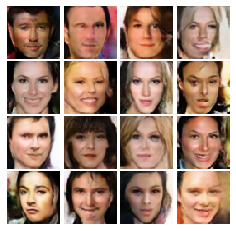


EPOCH:  46
Iter: 11100, D: 0.8882, G:0.5797


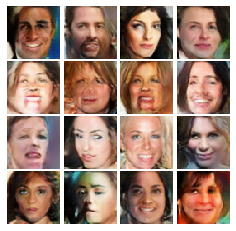


Iter: 11250, D: 0.8839, G:0.5001


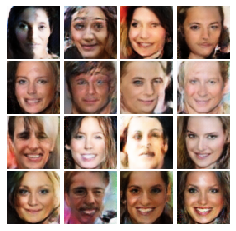


EPOCH:  47
Iter: 11400, D: 0.8956, G:0.6165


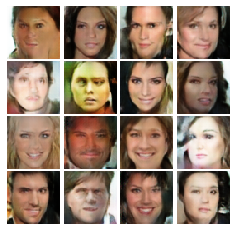


Iter: 11550, D: 0.8248, G:0.8505


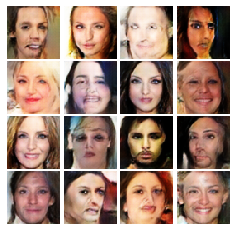


EPOCH:  48
Iter: 11700, D: 0.8742, G:0.5744


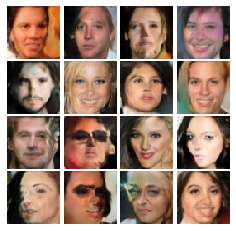


EPOCH:  49
Iter: 11850, D: 0.9109, G:0.6226


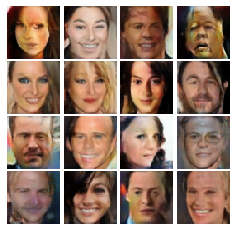


Iter: 12000, D: 0.9189, G:0.582


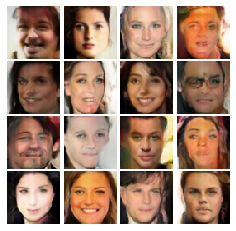


EPOCH:  50
Iter: 12150, D: 0.8758, G:0.5452


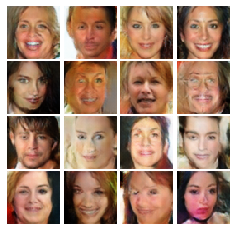

In [13]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=150,
          train_loader=celeba_loader_train, device=device)

### Train LS-GAN

In [14]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [15]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.5114, G:0.08557


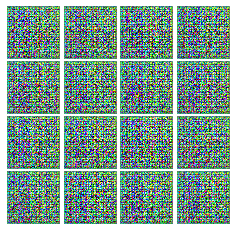


Iter: 200, D: 0.2169, G:0.221


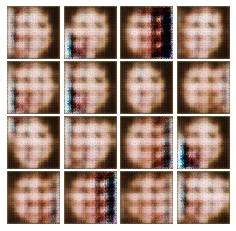


EPOCH:  2
Iter: 400, D: 0.4647, G:0.3481


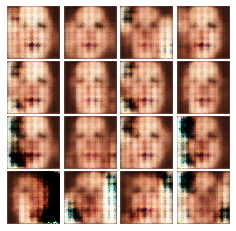


EPOCH:  3
Iter: 600, D: 0.2112, G:0.1901


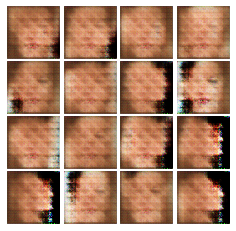


EPOCH:  4
Iter: 800, D: 0.1455, G:0.2191


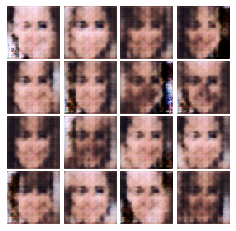


EPOCH:  5
Iter: 1000, D: 0.2384, G:0.2168


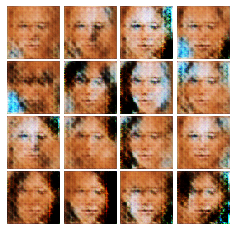


Iter: 1200, D: 0.2081, G:0.2343


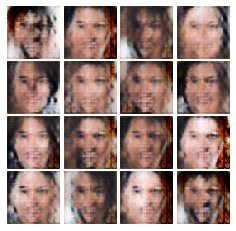


EPOCH:  6
Iter: 1400, D: 0.1615, G:0.2694


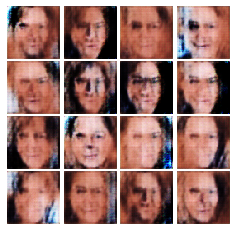


EPOCH:  7
Iter: 1600, D: 0.1805, G:0.236


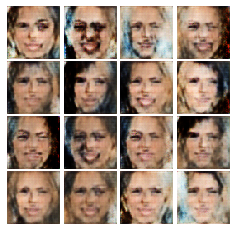


EPOCH:  8
Iter: 1800, D: 0.1577, G:0.3125


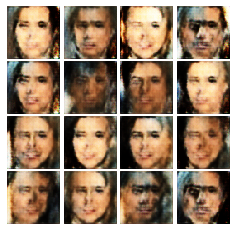


EPOCH:  9
Iter: 2000, D: 0.1901, G:0.2778


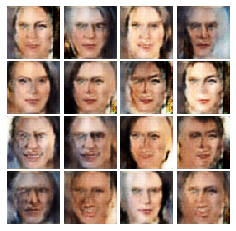


Iter: 2200, D: 0.2017, G:0.2684


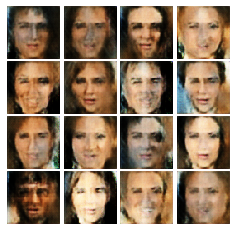


EPOCH:  10
Iter: 2400, D: 0.1581, G:0.3671


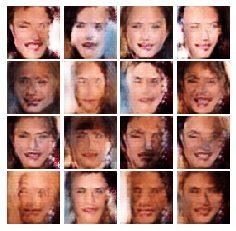


EPOCH:  11
Iter: 2600, D: 0.1638, G:0.2648


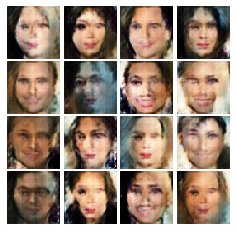


EPOCH:  12
Iter: 2800, D: 0.1542, G:0.2504


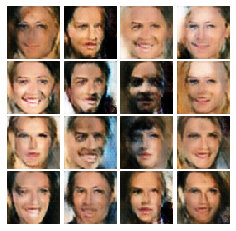


EPOCH:  13
Iter: 3000, D: 0.1664, G:0.3258


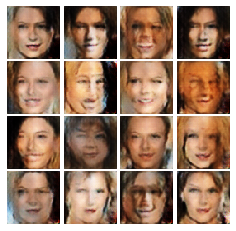


EPOCH:  14
Iter: 3200, D: 0.1446, G:0.278


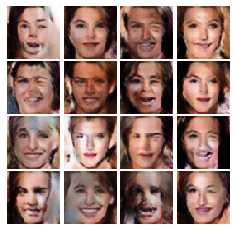


Iter: 3400, D: 0.216, G:0.2005


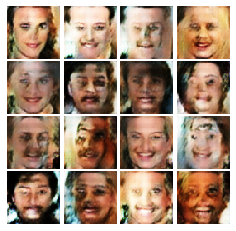


EPOCH:  15
Iter: 3600, D: 0.1555, G:0.2737


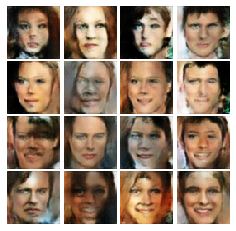


EPOCH:  16
Iter: 3800, D: 0.1666, G:0.2477


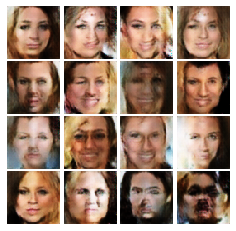


EPOCH:  17
Iter: 4000, D: 0.2176, G:0.2087


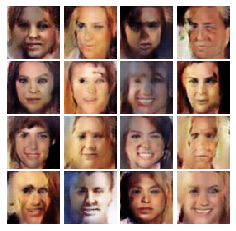


EPOCH:  18
Iter: 4200, D: 0.1769, G:0.2928


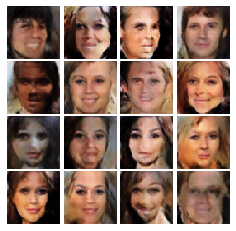


Iter: 4400, D: 0.2036, G:0.2827


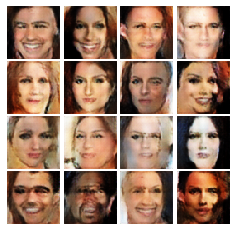


EPOCH:  19
Iter: 4600, D: 0.1818, G:0.2441


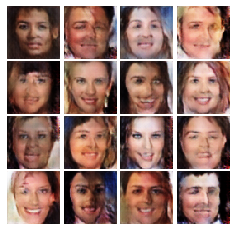


EPOCH:  20
Iter: 4800, D: 0.2045, G:0.289


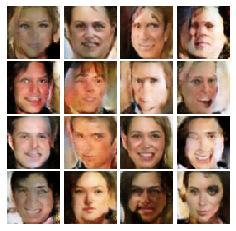


EPOCH:  21
Iter: 5000, D: 0.1741, G:0.2908


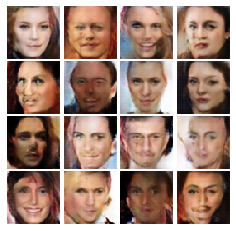


EPOCH:  22
Iter: 5200, D: 0.206, G:0.2115


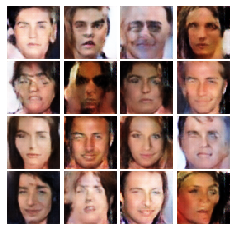


Iter: 5400, D: 0.1813, G:0.313


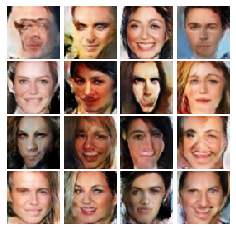


EPOCH:  23
Iter: 5600, D: 0.2046, G:0.2908


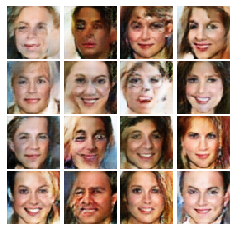


EPOCH:  24
Iter: 5800, D: 0.2158, G:0.2488


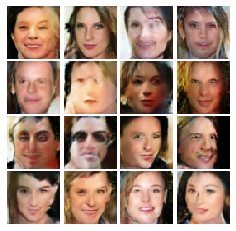


EPOCH:  25
Iter: 6000, D: 0.1825, G:0.2878


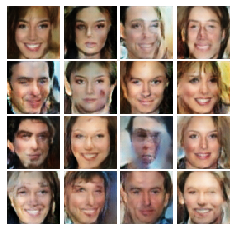


EPOCH:  26
Iter: 6200, D: 0.1839, G:0.271


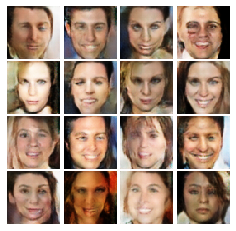


EPOCH:  27
Iter: 6400, D: 0.1977, G:0.2159


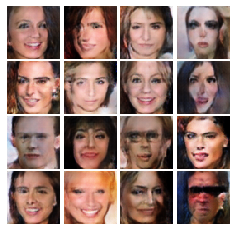


Iter: 6600, D: 0.1776, G:0.2622


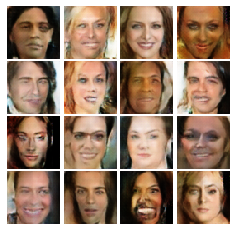


EPOCH:  28
Iter: 6800, D: 0.1833, G:0.2238


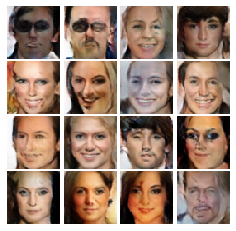


EPOCH:  29
Iter: 7000, D: 0.1975, G:0.2626


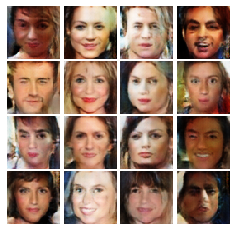


EPOCH:  30
Iter: 7200, D: 0.1723, G:0.2123


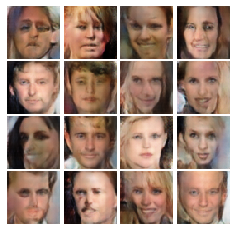


EPOCH:  31
Iter: 7400, D: 0.2177, G:0.2036


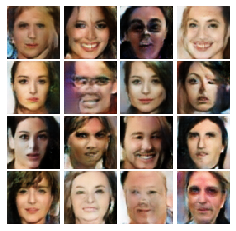


Iter: 7600, D: 0.1991, G:0.1981


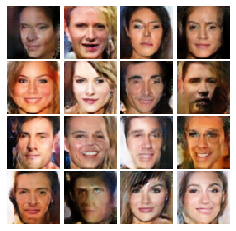


EPOCH:  32
Iter: 7800, D: 0.1943, G:0.218


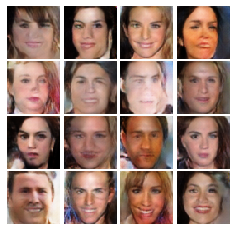


EPOCH:  33
Iter: 8000, D: 0.2033, G:0.2118


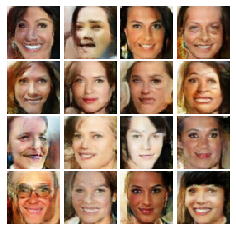


EPOCH:  34
Iter: 8200, D: 0.2012, G:0.2598


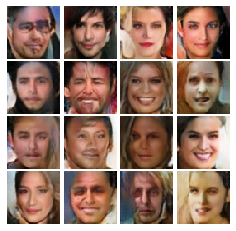


EPOCH:  35
Iter: 8400, D: 0.1873, G:0.1918


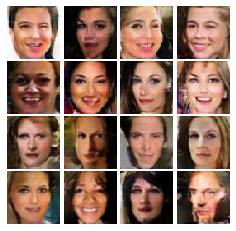


Iter: 8600, D: 0.2038, G:0.2291


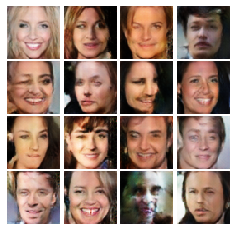


EPOCH:  36
Iter: 8800, D: 0.1931, G:0.2858


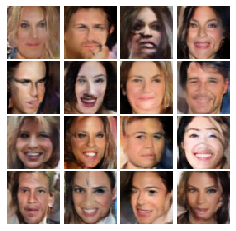


EPOCH:  37
Iter: 9000, D: 0.1976, G:0.1732


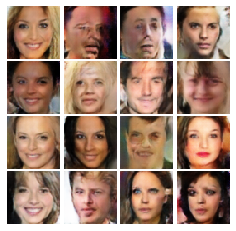


EPOCH:  38
Iter: 9200, D: 0.2194, G:0.2002


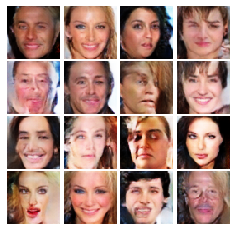


EPOCH:  39
Iter: 9400, D: 0.2116, G:0.2724


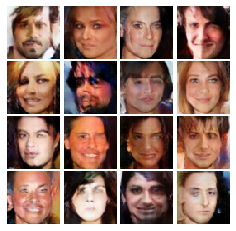


EPOCH:  40
Iter: 9600, D: 0.1875, G:0.1936


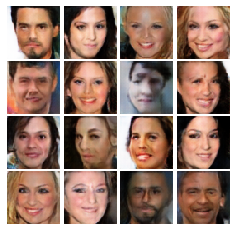


Iter: 9800, D: 0.2073, G:0.1863


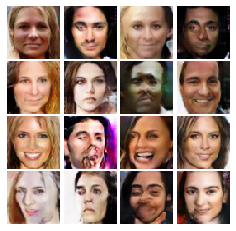


EPOCH:  41
Iter: 10000, D: 0.2095, G:0.2189


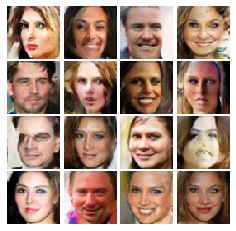


EPOCH:  42
Iter: 10200, D: 0.1832, G:0.1813


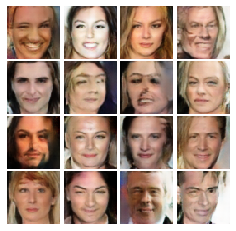


EPOCH:  43
Iter: 10400, D: 0.2026, G:0.2585


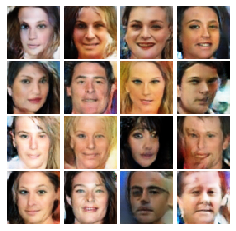


EPOCH:  44
Iter: 10600, D: 0.1889, G:0.1699


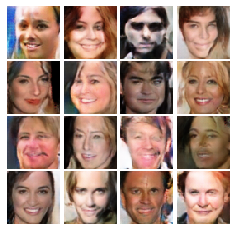


Iter: 10800, D: 0.2032, G:0.1759


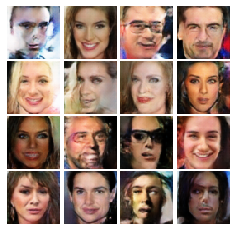


EPOCH:  45
Iter: 11000, D: 0.2351, G:0.3499


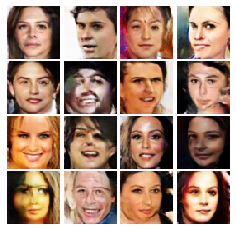


EPOCH:  46
Iter: 11200, D: 0.2072, G:0.2537


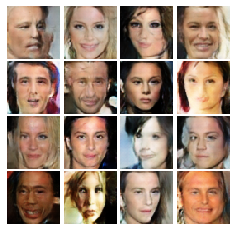


EPOCH:  47
Iter: 11400, D: 0.1843, G:0.2539


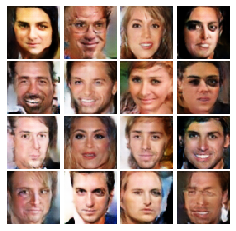


EPOCH:  48
Iter: 11600, D: 0.2239, G:0.1785


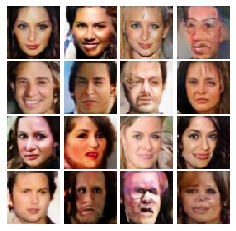


Iter: 11800, D: 0.2024, G:0.1773


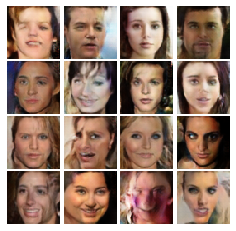


EPOCH:  49
Iter: 12000, D: 0.2008, G:0.2093


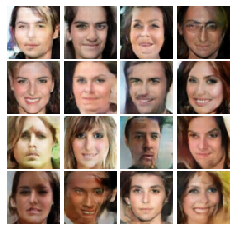


EPOCH:  50
Iter: 12200, D: 0.1781, G:0.1949


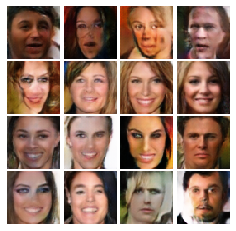

In [16]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=200,
          train_loader=celeba_loader_train, device=device)